In [ ]:
# Conectar google colab con google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
path = '/content/drive/MyDrive/APSE/4.2.1_taxis_san_francisco/DATA/'

In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from datetime import timedelta
import datetime as dt
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = [16, 10]
import seaborn as sns
import os
import folium
from folium.plugins import HeatMap

# 1. Carga de datos:
Dataset disponible en forma de archivos .txt, uno para cada taxi único (definido en el nombre del path). Contienen datos de latitud, longitud, ocupación y tiempo (en tiempo UNIX)
Cargar los datos desde los .txt en objeto tipo Dataframe
Añadir el nombre del archivo como ID del taxi en concreto, tantas veces como número de filas haya


In [ ]:
df = {"id": [], "lat": [], "long": [], "occ": [], "time": []}

for subdir, dirs, files in os.walk(path):
    for file in files:
        if file.endswith(".txt"):
            f_name = file.split("_")[1].split(".")[0]
            data = np.loadtxt(path+file)
            #-------------------
            df["lat"]+=data[:,0].tolist()
            df["long"]+=data[:,1].tolist()
            df["occ"]+=data[:,2].tolist()
            df["time"]+=data[:,3].tolist()
            df["id"]+=[str(f_name)]*len(data)
            #--------------------

df = pd.DataFrame(data=df)

# 2. Entender datos
- Tipos de datos por columna
- Campo 'id' debe de ser único para cada archivo
- La categoría 'occ' solo puede tener valores 0 - libre o 1 - ocupado
- ¿Hay algun dato incompleto?

In [ ]:
print('Dimensiones del dataset: Tenemos {} muestras de datos (filas) y {} categorías (columnas).'.format(df.shape[0], df.shape[1]))
print(df.dtypes)
print('Id es único.') if df["id"].nunique() == df.shape[0] else print('Id no es único - hay algún problema en esta categoría')
print('Ocupación solo tiene dos valores posibles: 0 y 1 {}.'.format(str(set(df["occ"].unique()) | set(df["occ"].unique()))))
print('No hay datos incompletos.') if df.count().min() == df.shape[0] else print('Hay datos incompletos')
print(df.head())

Dimensiones del dataset: Tenemos 10447156 muestras de datos (filas) y 5 categorías (columnas).
id       object
lat     float64
long    float64
occ     float64
time    float64
dtype: object
Id no es único - hay algún problema en esta categoría
Ocupación solo tiene dos valores posibles: 0 y 1 {0.0, 1.0}.
No hay datos incompletos.
         id       lat       long  occ          time
0  ayshekki  37.66635 -122.42869  0.0  1.212996e+09
1  ayshekki  37.66642 -122.42865  0.0  1.212996e+09
2  ayshekki  37.66768 -122.42524  0.0  1.212996e+09
3  ayshekki  37.66859 -122.41505  0.0  1.212995e+09
4  ayshekki  37.66530 -122.40215  0.0  1.212995e+09


# 3. Graficación
Visualizar la posición gps ('lat' y 'lon') de todos los taxis considerados


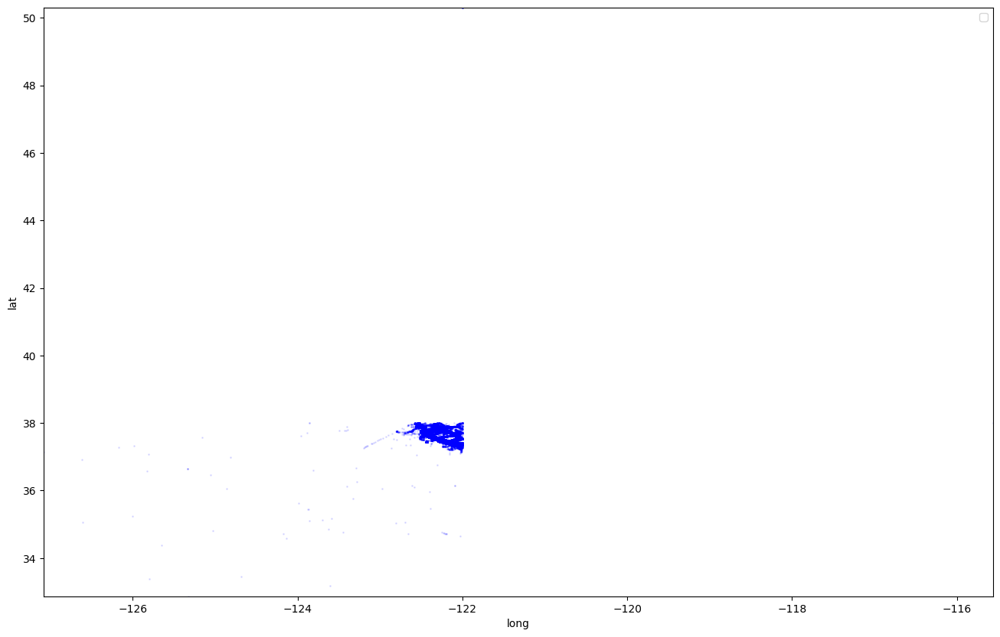

In [ ]:
N = df.count().min()

city_long_border = (np.amin(df['long']), np.amax(df['long']))
city_lat_border = (np.amin(df['lat']), np.amax(df['lat']))

fig, ax = plt.subplots(ncols=1)
ax.scatter(df['long'].values[:N], df['lat'].values[:N],
              color='blue', s=1, alpha=0.1)
ax.legend(loc=0)
ax.set_ylabel('lat')
ax.set_xlabel('long')
plt.ylim(city_lat_border)
plt.xlim(city_long_border)
plt.show()

# 3. Graficación (cont).
Visualizar la posición gps ('lat' y 'lon') de taxis uno por uno, o por subconjuntos.
Obtener varias gráficas de distintos taxis, o grupos de taxis
Para ello, se requiere localizar en dataframe los índices de qué filas pertenecen a cada 'id'
-i1: fila donde empiezan los datos de un taxi concreto, o subconjunto de taxis a analizar
-i2: fila donde terminan los datos de un taxi concreto, o subconjunto de taxis a analizar

¿Qué diferencias se pueden observar para cada caso?


In [ ]:
df_grouped = df.groupby('id').agg({'lat': lambda x: list(x),
                                   'long': lambda x: list(x),
                                   'occ': lambda x: list(x),
                                   'time': lambda x: list(x)})

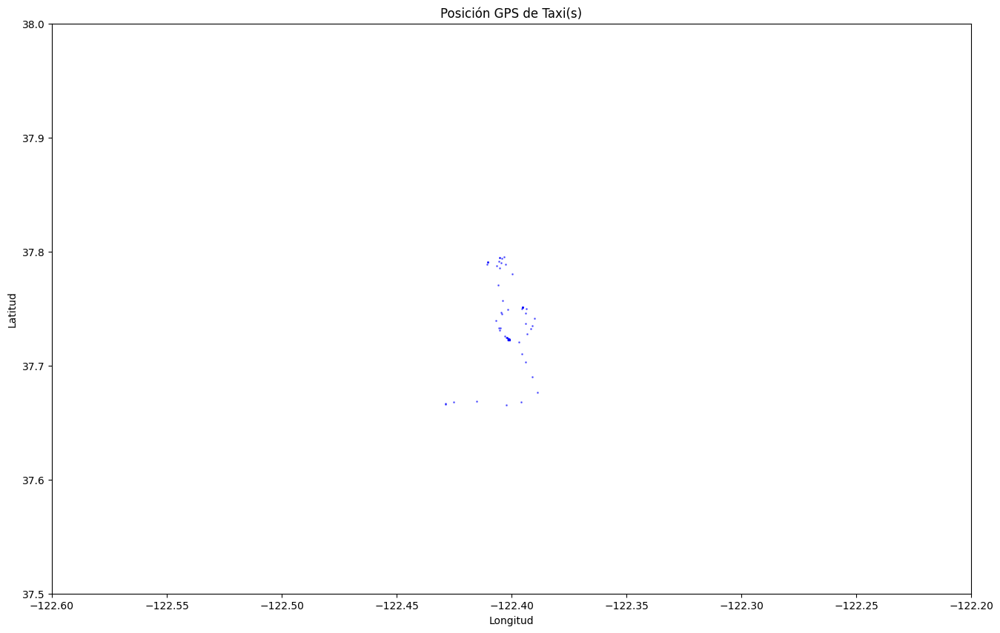

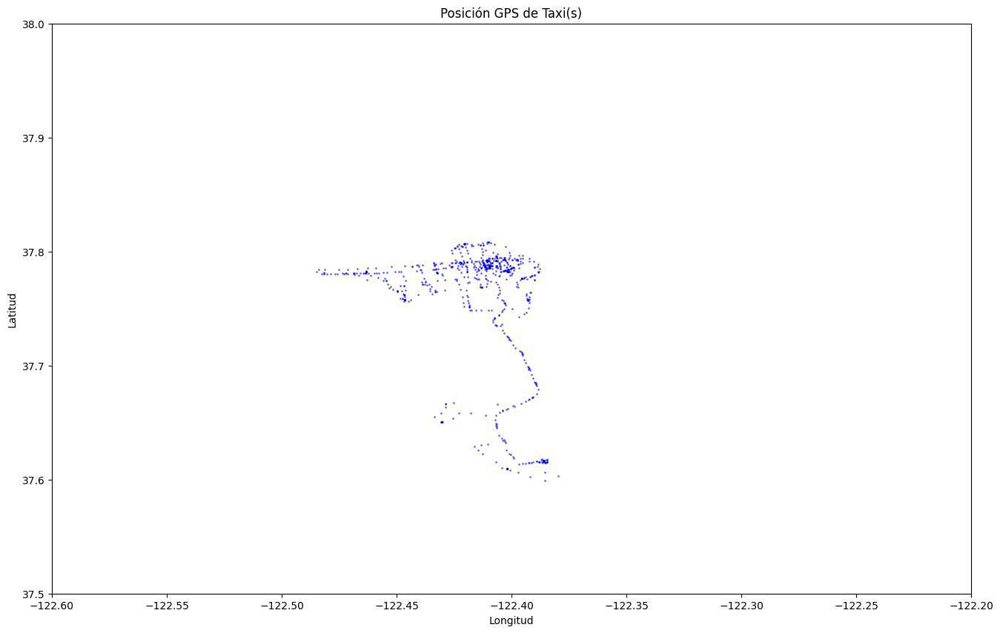

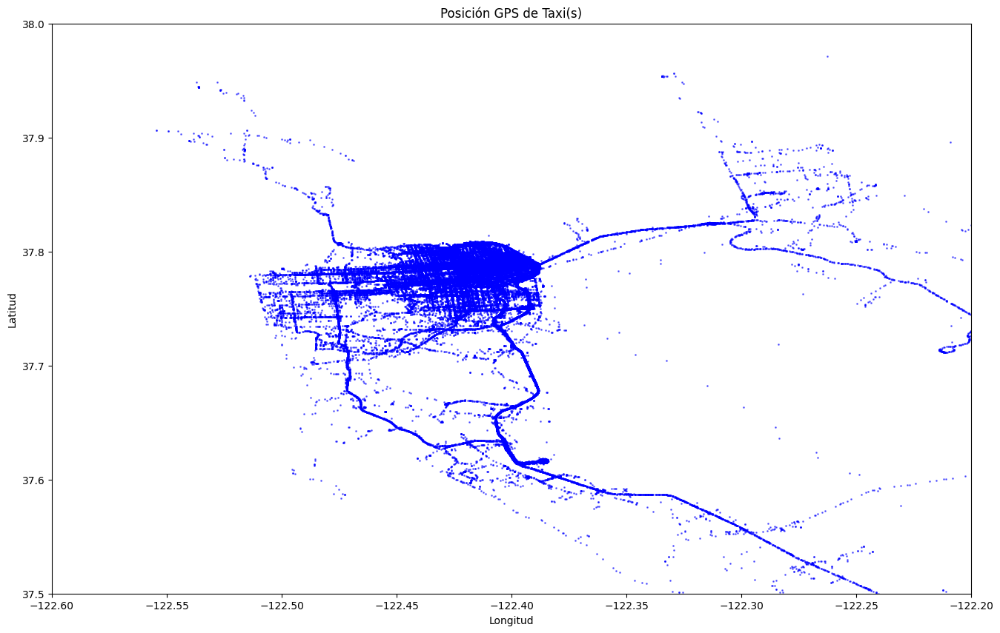

In [ ]:
import matplotlib.pyplot as plt

def visualizar_taxis(df, i1, i2, long_range, lat_range):
    fig, ax = plt.subplots()
    ax.scatter(df.iloc[i1:i2]['long'], df.iloc[i1:i2]['lat'], color='blue', s=1, alpha=0.5)
    ax.set_ylabel('Latitud')
    ax.set_xlabel('Longitud')
    ax.set_title('Posición GPS de Taxi(s)')
    ax.set_xlim(long_range)
    ax.set_ylim(lat_range)
    plt.show()


long_range = (-122.6, -122.2)
lat_range = (37.5, 38)

i1_taxi_1 = 0  # Índice de inicio del primer taxi
i2_taxi_1 = 100  # Índice de final del primer taxi (ajusta según tus datos)
visualizar_taxis(df, i1_taxi_1, i2_taxi_1, long_range, lat_range)


i1_taxi_1 = 100  # Índice de inicio del primer taxi
i2_taxi_1 = 1000  # Índice de final del primer taxi (ajusta según tus datos)
visualizar_taxis(df, i1_taxi_1, i2_taxi_1, long_range, lat_range)


i1_taxi_1 = 0  # Índice de inicio del primer taxi
i2_taxi_1 = 140000  # Índice de final del primer taxi (ajusta según tus datos)
visualizar_taxis(df, i1_taxi_1, i2_taxi_1, long_range, lat_range)

In [ ]:
# Filter the df_grouped dataset for the ID 'uvigcho'
filtered_data = df_grouped.loc['abmuyawm']

heat_data = filtered_data[['lat', 'long']]
coordenadas = [[lat, long] for lat, long in zip(heat_data['lat'], heat_data['long'])]
coordenadas
# Create a Folium map
m = folium.Map(location=(37.7, -122.4),zoom_start=11)

folium.PolyLine(coordenadas).add_to(m)

# Display the map
m

Ahora vamos a ordenar los trayectos segun los taxis estén ocupados o no .

In [ ]:
#ahora hacer sobre el  dataframe df seleccionamos un taxi y pintamos las trayectorias en rojo si occ=1 y en verde si es 0
filtered_data = df[df['id'] == 'abmuyawm']
#coger las latitudes y longitudes cuando esta ocupado
ocupado = filtered_data[filtered_data['occ'] == 1][['lat', 'long']]
# coger las latitudes y longitudes cuando no esta ocupado
no_ocupado = filtered_data[filtered_data['occ'] == 0][['lat', 'long']]
# Create a Folium map
m = folium.Map(location=(37.7, -122.4),zoom_start=11)
#pintar las lineas de trayectorias de ocupado en rojo y de no ocupado en verde
folium.PolyLine(ocupado[['lat', 'long']], color="red").add_to(m)
folium.PolyLine(no_ocupado[['lat', 'long']], color="green").add_to(m)
# Display the map
m

Podemos ver que este mapa no esta muy bien hecho ya que hay muchas lineas incorrectas. Esto se debe a que los trayectos no estan bien definidos

In [ ]:
ocupado[['lat', 'long']]

,lat,long
5179660,37.78127,-122.39581
5179661,37.77969,-122.39374
5179662,37.77685,-122.39518
5179668,37.78069,-122.39071
5179669,37.78254,-122.39342
...,...,...
5202452,37.78184,-122.45307
5202453,37.78323,-122.44099
5202454,37.78502,-122.42817
5202455,37.78533,-122.42521


Ahora vamos a ordenar cada trayecto, viendo los indices y viendo si son consecutivos, es decir, son el mismo viaje

In [ ]:
indice_anterior_ocupado=5179660-1
lista_ocupados =[]
lista=[]
for index in ocupado.index:
    if index == indice_anterior_ocupado+1:
        lista.append(ocupado.loc[index])
    else:
        lista_ocupados.append(lista)
        lista=[]
        lista.append(ocupado.loc[index])
    indice_anterior_ocupado=index

indice_anterior_no_ocupado=5179663-1
lista_no_ocupados =[]
lista=[]
for index in no_ocupado.index:
    if index == indice_anterior_no_ocupado+1:
        lista.append(no_ocupado.loc[index])
    else:
        lista_no_ocupados.append(lista)
        lista=[]
        lista.append(no_ocupado.loc[index])
    indice_anterior_no_ocupado=index


In [ ]:
i=pd.DataFrame(lista_ocupados[0])
i[['lat', 'long']]

,lat,long
5179660,37.78127,-122.39581
5179661,37.77969,-122.39374
5179662,37.77685,-122.39518


T

In [ ]:
# Create a Folium map
m = folium.Map(location=(37.7, -122.4),zoom_start=11)
#pintar las lineas de trayectorias de ocupado en rojo y de no ocupado en verde
for i in lista_ocupados:
  i=pd.DataFrame(i)
  folium.PolyLine(pd.DataFrame(i)[['lat', 'long']], color="red").add_to(m)
for x in lista_no_ocupados:
  folium.PolyLine(pd.DataFrame(x)[['lat', 'long']], color="green").add_to(m)
# Display the map
m

En este mapa podemos observar que hemos arreglado el problema y se ven claramente los trayectos que estan con el taxi ocupado y los que no

Ahora vamos a ver para este taxi en concreto si tiene mas trayectos con el taxi ocupado o con el taxi libre

In [ ]:
print("Número de trayectorias ocupadas: ", len(lista_ocupados))
print("Número de trayectorias no ocupadas: ", len(lista_no_ocupados))

Número de trayectorias ocupadas:  922
Número de trayectorias no ocupadas:  921


El resultado que obtenemos es el esperado ya que a menos que justo coja a un pasajero despues de acabar un trayecto, el taxi va a hacer los mismos trayectos con el taxi vacio que con el taxi ocupado.
El analisis lo deberiamos centrar en la distancia que recorre con cada uno:

Para ello realizamos una funcion que calcula la distancia entre 2 puntos dado la latitud y longitud

In [ ]:
#funcion que calcula distancias entre dos puntos dados la latitud y longitud
from math import sin, cos, sqrt, atan2, radians
def calculate_distance(lat1, lon1, lat2, lon2):
    # approximate radius of earth in km
    R = 6373.0

    lat1 = radians(lat1)
    lon1 = radians(lon1)
    lat2 = radians(lat2)
    lon2 = radians(lon2)

    dlon = lon2 - lon1
    dlat = lat2 - lat1

    a = sin(dlat / 2)**2 + cos(lat1) * cos(lat2) * sin(dlon / 2)**2
    c = 2 * atan2(sqrt(a), sqrt(1 - a))

    distance = R * c

    return distance

Aplicamos la función al taxi para ver con que trayectos recorre la mayor distancia:

In [ ]:
#calculamos la distancia recorrida ocupado y no ocupado
distancias_ocupado=[]
for i in lista_ocupados:
    distancia=0
    for j in range(len(i)-1):
        distancia+=calculate_distance(i[j]['lat'],i[j]['long'],i[j+1]['lat'],i[j+1]['long'])
    distancias_ocupado.append(distancia)
distancias_no_ocupado=[]
for i in lista_no_ocupados:
    distancia=0
    for j in range(len(i)-1):
        distancia+=calculate_distance(i[j]['lat'],i[j]['long'],i[j+1]['lat'],i[j+1]['long'])
    distancias_no_ocupado.append(distancia)
#sumar todas las distancias en la lista
distancia_total_ocupado=0
for i in distancias_ocupado:
    distancia_total_ocupado+=i
distancia_total_no_ocupado=0
for i in distancias_no_ocupado:
    distancia_total_no_ocupado+=i
print("Distancia total recorrida por el taxi ocupado (km): ", distancia_total_ocupado)
print("Distancia total recorrida por el taxis no ocupado (km): ", distancia_total_no_ocupado)

Distancia total recorrida por el taxi ocupado (km):  4675.218202837734
Distancia total recorrida por el taxis no ocupado (km):  3208.231889143293


Podemos ver que se reccorre mas distancia con el taxi ocupado, lo que es buena señal, sin embargo no llega a ser completamente optimo ya que la distancia con el taxi vacio es bastante grande lo que supone un gasto grande en combustible.

Para generalizar esta metrica, vamos a hacer la media para todo el dataframe:

In [ ]:
distancias_ocupado=[]
distancias_no_ocupado=[]
for id in df['id'].unique():
    filtered_data = df[df['id'] == id]
    ocupado = filtered_data[filtered_data['occ'] == 1][['lat', 'long']]
    no_ocupado = filtered_data[filtered_data['occ'] == 0][['lat', 'long']]
    indice_anterior_ocupado=0
    lista_ocupados =[]
    lista=[]
    for index in ocupado.index:
        if index == indice_anterior_ocupado+1:
            lista.append(ocupado.loc[index])
        else:
            lista_ocupados.append(lista)
            lista=[]
            lista.append(ocupado.loc[index])
        indice_anterior_ocupado=index

    indice_anterior_no_ocupado=0
    lista_no_ocupados =[]
    lista=[]
    for index in no_ocupado.index:
        if index == indice_anterior_no_ocupado+1:
            lista.append(no_ocupado.loc[index])
        else:
            lista_no_ocupados.append(lista)
            lista=[]
            lista.append(no_ocupado.loc[index])
        indice_anterior_no_ocupado=index
    distancias_ocupado_id=[]
    for i in lista_ocupados:
        distancia=0
        for j in range(len(i)-1):
            distancia+=calculate_distance(i[j]['lat'],i[j]['long'],i[j+1]['lat'],i[j+1]['long'])
        distancias_ocupado_id.append(distancia)
    distancias_no_ocupado_id=[]
    for i in lista_no_ocupados:
        distancia=0
        for j in range(len(i)-1):
            distancia+=calculate_distance(i[j]['lat'],i[j]['long'],i[j+1]['lat'],i[j+1]['long'])
        distancias_no_ocupado_id.append(distancia)
    distancia_total_ocupado_id=0
    for i in distancias_ocupado_id:
        distancia_total_ocupado_id+=i
    distancia_total_no_ocupado_id=0
    for i in distancias_no_ocupado_id:
        distancia_total_no_ocupado_id+=i
    distancias_ocupado.append(distancia_total_ocupado_id)
    distancias_no_ocupado.append(distancia_total_no_ocupado_id)


print("Distancia media recorrida por taxis ocupados: ", sum(distancias_ocupado)/len(distancias_ocupado))
print("Distancia media recorrida por taxis no ocupados: ", sum(distancias_no_ocupado)/len(distancias_no_ocupado))

Distancia media recorrida por taxis ocupados:  5015.276210288652
Distancia media recorrida por taxis no ocupados:  4008.9637863896287


Podemos ver que el resultado algo superior al de taxi anterior. La distancia recorrida por taxis ocupados es ligeramente mayor a la de los taxis no ocupados, lo que denota un problema de optimización de recorridos

# 4. Análisis de frecuencia de posiciones
-Generar mapa de calor de las posiciones ('lat, 'long')
-Describir el resultado. ¿Qué llama la atención de este mapa?

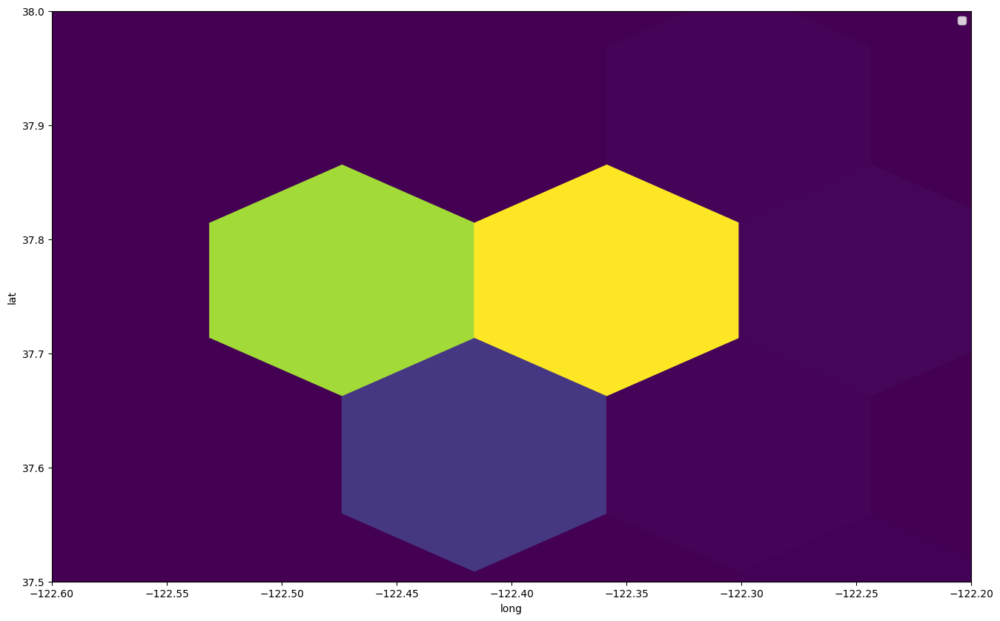

In [ ]:
long_range = (-122.6, -122.2)
lat_range = (37.5, 38)
fig, ax = plt.subplots(ncols=1)
plt.hexbin(df["long"],df["lat"])
plt.ylim(city_lat_border)
plt.xlim(city_long_border)
ax.legend(loc=0)
ax.set_ylabel('lat')
ax.set_xlabel('long')
ax.set_xlim(long_range)
ax.set_ylim(lat_range)
plt.show()


No hay resultados significativos, ya que se esta usando el dataset entero.

Vamos a crear un dataframe con los taxis agrupados:

In [ ]:
df_grouped = df.groupby('id').agg({'lat': lambda x: list(x),
                                   'long': lambda x: list(x),
                                   'occ': lambda x: list(x),
                                   'time': lambda x: list(x)})


In [ ]:
df_grouped

,lat,long,occ,time
id,,,,
abboip,"[37.75134, 37.75136, 37.75199, 37.7508, 37.750...","[-122.39488, -122.39527, -122.3946, -122.39346...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[1213084687.0, 1213084659.0, 1213084540.0, 121..."
abdremlu,"[37.61625, 37.61622, 37.61619, 37.6153, 37.629...","[-122.38587, -122.38583, -122.38588, -122.3897...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[1213036400.0, 1213036340.0, 1213036302.0, 121..."
abgibo,"[37.7638, 37.76127, 37.76128, 37.76517, 37.764...","[-122.39769, -122.39841, -122.39841, -122.4176...","[0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, ...","[1213088836.0, 1213088776.0, 1213088750.0, 121..."
abjoolaw,"[37.76943, 37.77009, 37.77084, 37.7718, 37.772...","[-122.42457, -122.4248, -122.42523, -122.42537...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, ...","[1213037526.0, 1213037498.0, 1213037440.0, 121..."
abmuyawm,"[37.78127, 37.77969, 37.77685, 37.77654, 37.77...","[-122.39581, -122.39374, -122.39518, -122.3954...","[1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, ...","[1213037376.0, 1213037316.0, 1213037256.0, 121..."
...,...,...,...,...
uvburki,"[37.77196, 37.7713, 37.77288, 37.7701, 37.7662...","[-122.40716, -122.40546, -122.40274, -122.3995...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[1213038289.0, 1213038227.0, 1213038199.0, 121..."
uvigcho,"[37.61571, 37.6149, 37.60821, 37.59975, 37.591...","[-122.38804, -122.39129, -122.38852, -122.3759...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[1213036859.0, 1213036810.0, 1213036734.0, 121..."
uvjeahot,"[37.61569, 37.61453, 37.61553, 37.61553, 37.61...","[-122.38797, -122.39479, -122.38991, -122.3899...","[0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...","[1213033832.0, 1213033781.0, 1213033713.0, 121..."


# 4. Análisis de frecuencia de posiciones
-Generar mapa de calor de las posiciones ('lat, 'long')

-Ejercicio: Obtener varias gráficas de distintos taxis, o grupos de taxis
Para ello, se requiere localizar en dataframe los índices de qué filas pertenecen a cada 'id'
-i1: fila donde empiezan los datos de un taxi concreto, o subconjunto de taxis a analizar
-i2: fila donde terminan los datos de un taxi concreto, o subconjunto de taxis a analizar

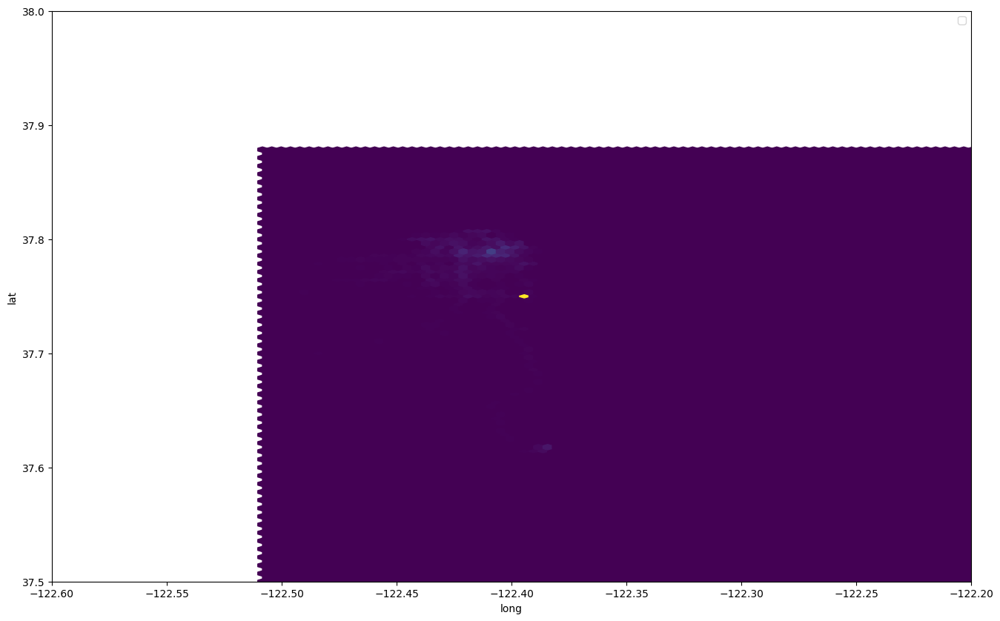

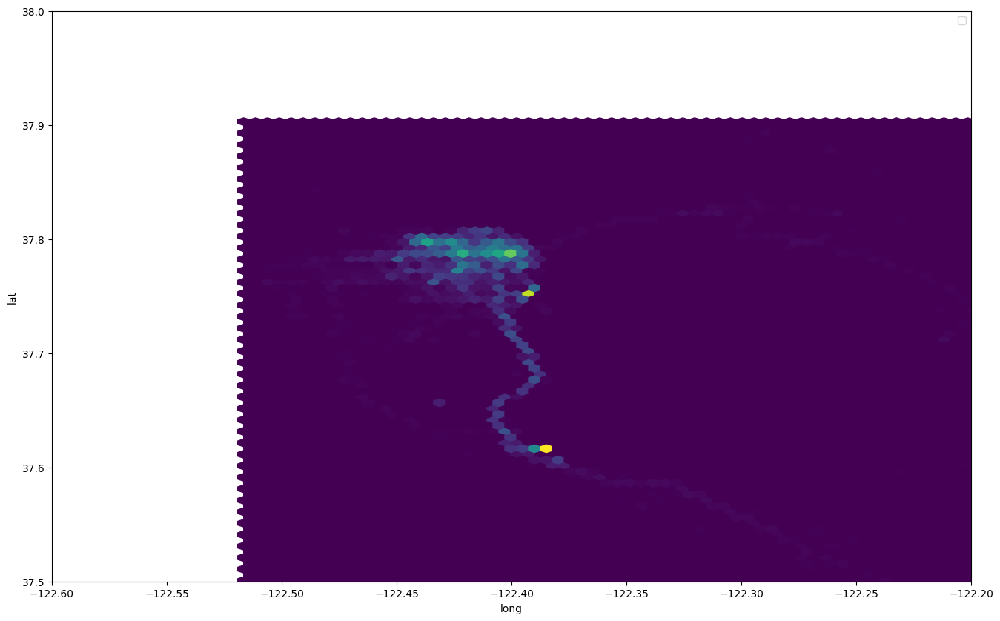

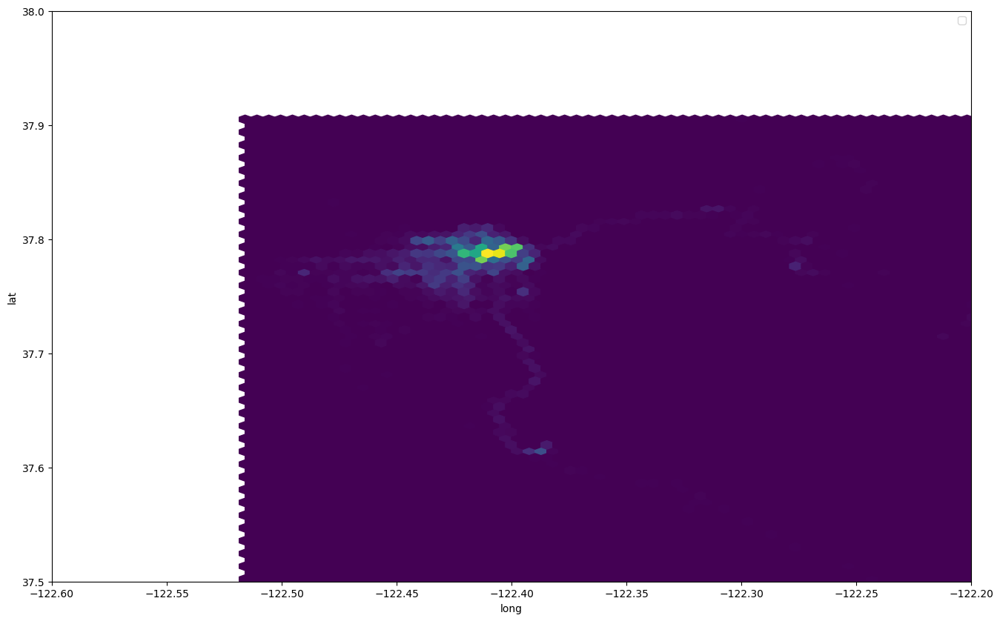

In [ ]:
import matplotlib.pyplot as plt

def visualizar_taxis(df, taxi_id, long_range, lat_range):
    taxi_data = df[df['id'] == taxi_id]
    fig, ax = plt.subplots(ncols=1)
    plt.hexbin(taxi_data['long'], taxi_data['lat'])
    plt.ylim(lat_range)
    plt.xlim(long_range)
    ax.legend(loc=0)
    ax.set_ylabel('lat')
    ax.set_xlabel('long')
    ax.set_xlim(long_range)
    ax.set_ylim(lat_range)
    plt.show()


long_range = (-122.6, -122.2)
lat_range = (37.5, 38)

taxi_id_1 = 'abboip'  # ID del primer taxi
visualizar_taxis(df, taxi_id_1, long_range, lat_range)

taxi_id_2 = 'abdremlu'  # ID del segundo taxi
visualizar_taxis(df, taxi_id_2, long_range, lat_range)

taxi_id_3 = 'uvigcho'  # ID del tercer taxi
visualizar_taxis(df, taxi_id_3, long_range, lat_range)

In [ ]:
heat_data = filtered_data[['lat', 'long']]
coordenadas = [[lat, long] for lat, long in zip(heat_data['lat'], heat_data['long'])]
coordenadas

[[37.78127, -122.39581],
 [37.77969, -122.39374],
 [37.77685, -122.39518],
 [37.77654, -122.39543],
 [37.7766, -122.39542],
 [37.77595, -122.39642],
 [37.77904, -122.39269],
 [37.78067, -122.39072],
 [37.78069, -122.39071],
 [37.78254, -122.39342],
 [37.78565, -122.39686],
 [37.78538, -122.40007],
 [37.78938, -122.40134],
 [37.78896, -122.40232],
 [37.78868, -122.40511],
 [37.78867, -122.40541],
 [37.78829, -122.408],
 [37.78743, -122.41252],
 [37.7862, -122.42465],
 [37.7862, -122.42465],
 [37.78718, -122.42476],
 [37.7875, -122.42317],
 [37.7875, -122.42317],
 [37.78745, -122.42211],
 [37.78803, -122.42018],
 [37.78868, -122.42185],
 [37.7886, -122.42207],
 [37.78973, -122.42219],
 [37.7932, -122.42305],
 [37.79375, -122.42458],
 [37.79265, -122.42282],
 [37.79111, -122.42247],
 [37.78907, -122.42503],
 [37.78752, -122.42435],
 [37.7875, -122.42443],
 [37.78793, -122.41863],
 [37.78923, -122.41707],
 [37.78923, -122.41707],
 [37.79032, -122.41447],
 [37.79097, -122.4092],
 [37.79379,

In [ ]:


# Create a Folium map
m = folium.Map(location=(37.7, -122.4),zoom_start=11)

# Filter the df_grouped dataset for the ID 'uvigcho'
filtered_data = df_grouped.loc['uvigcho']

# Create a HeatMap layer with the latitudes and longitudes from the filtered_data

HeatMap(coordenadas).add_to(m)

# Display the map
m


Podemos comprobar que efectvamente el mapa de calor concuerda con los puntos más concurridos, la zona del ferry o el aeropuerto

# 5. Análisis de frecuencia de tiempos
-Graficar histograma de tiempos de un conjunto o subconjunto de los datos
Convertir categoría 'time' de tiempo UNIX a tiempo normal
Describir patrón del histograma, ¿por qué hay picos y valles? ¿Cual es el espaciado? ¿A qué se puede deber?
A lo largo del período medido, ¿cuáles son las horas de mayor actividad de conducción?

,id,lat,long,occ,time,time_conv
0,ayshekki,37.66635,-122.42869,0.0,1.212996e+09,2008-06-09 07:13:42
1,ayshekki,37.66642,-122.42865,0.0,1.212996e+09,2008-06-09 07:12:51
2,ayshekki,37.66768,-122.42524,0.0,1.212996e+09,2008-06-09 07:11:41
3,ayshekki,37.66859,-122.41505,0.0,1.212995e+09,2008-06-09 07:10:51
4,ayshekki,37.66530,-122.40215,0.0,1.212995e+09,2008-06-09 07:09:41


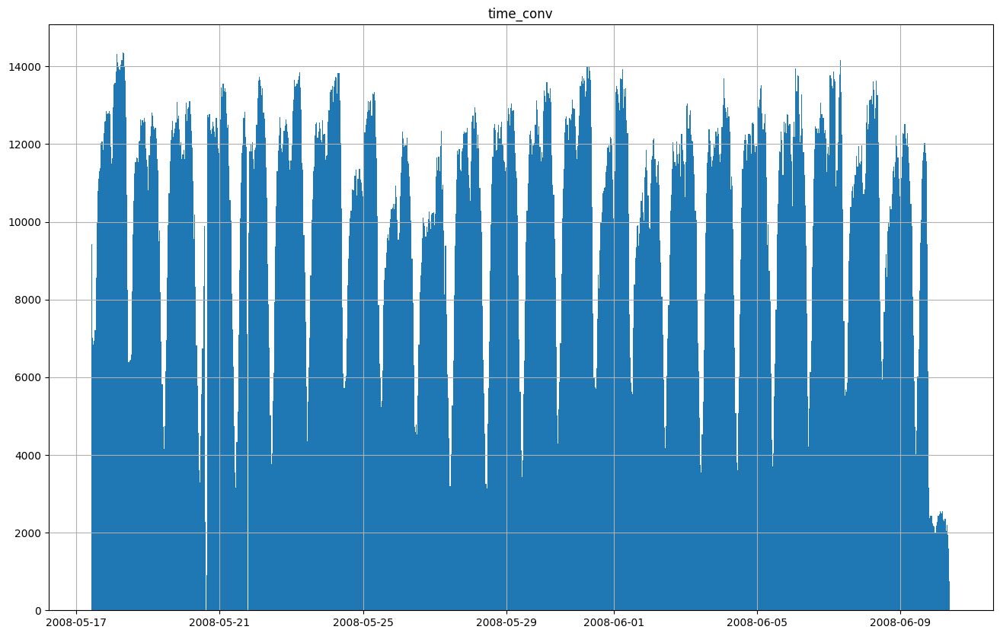

In [ ]:
'''
Pasar numero tiempo UNIX a tiempo normal
'''
df['time_conv'] = pd.to_datetime(df['time'], unit='s')
df['time_conv'] = pd.to_datetime(df['time_conv'], format='%Y-%m-%d %H:%M:%S')
hist = df.hist(column='time_conv', bins=1000)
df.head()


Al tranformar en gráfico el conjunto de datos podemos darnos cuenta de diferentes picos y valles a lo largo de la semana, estos valles se pueden identificar como el poco uso de taxis dado a que la hora que se trata.

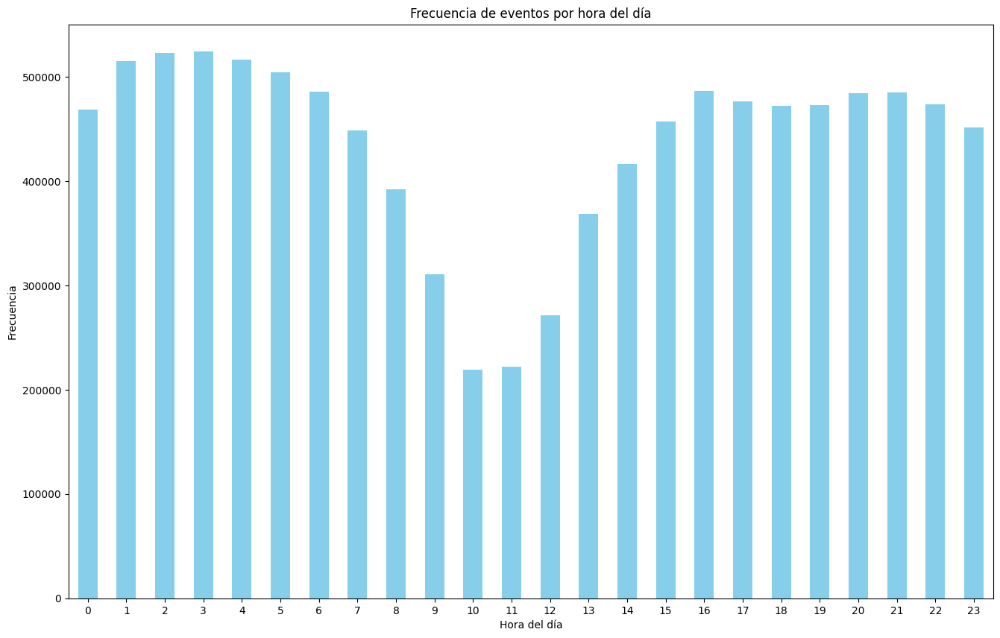

In [ ]:
# Extraer la hora del día de la columna de tiempo convertido
df['hour'] = df['time_conv'].dt.hour

# Crear el histograma agrupando los datos por hora y contando la frecuencia de eventos en cada hora
hist = df.groupby('hour').size().plot(kind='bar', color='skyblue')

plt.title('Frecuencia de eventos por hora del día')
plt.xlabel('Hora del día')
plt.ylabel('Frecuencia')
plt.xticks(rotation=0)
plt.show()

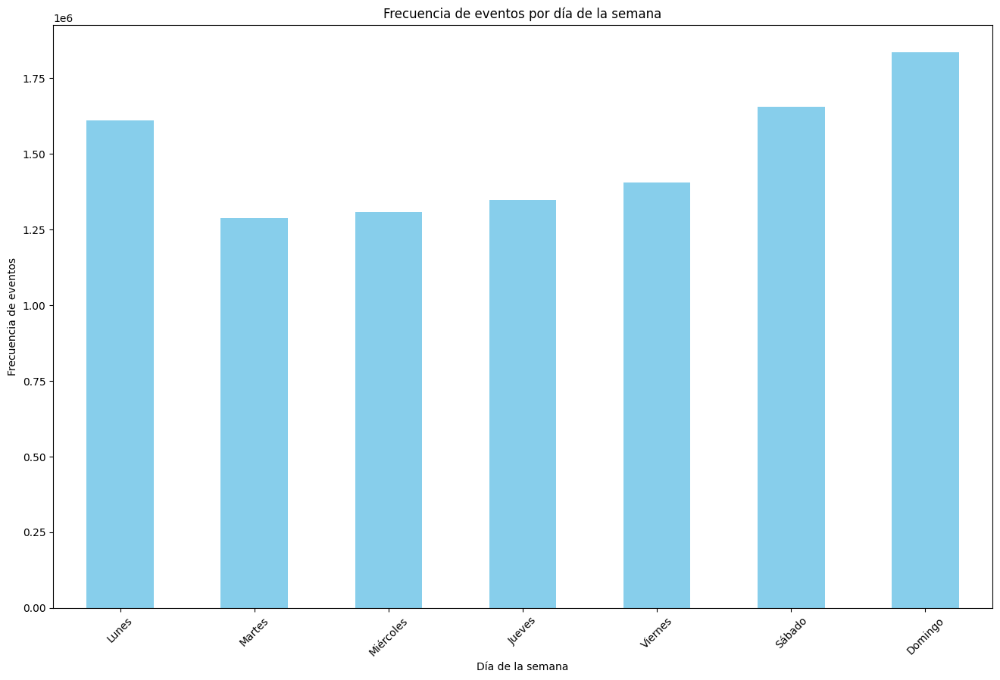

In [ ]:
# Extraer el día de la semana de la columna de tiempo convertido (0: Lunes, 1: Martes, ..., 6: Domingo)
df['day_of_week'] = df['time_conv'].dt.dayofweek

# Mapear el número del día de la semana al nombre del día
dias_semana = {0: 'Lunes', 1: 'Martes', 2: 'Miércoles', 3: 'Jueves', 4: 'Viernes', 5: 'Sábado', 6: 'Domingo'}
df['nombre_dia'] = df['day_of_week'].map(dias_semana)

# Crear el histograma agrupando los datos por día de la semana y contando la frecuencia de eventos en cada día
hist = df.groupby('nombre_dia').size().reindex(dias_semana.values()).plot(kind='bar', color='skyblue')

# Configurar el título y las etiquetas de los ejes
plt.title('Frecuencia de eventos por día de la semana')
plt.xlabel('Día de la semana')
plt.ylabel('Frecuencia de eventos')
plt.xticks(rotation=45)  # Rotar las etiquetas del eje x para una mejor legibilidad

# Mostrar la gráfica
plt.show()

# 6. Análisis de frecuencia de paradas
Graficar histograma de paradas de un conjunto o subconjunto de los datos
Parada: diferencia de tiempo en segundos entre una muestra de tiempo y la anterior para el mismo taxi
Es necesario un preproceso de forma que se recorran los tiempos, se resten las muestras sucesivas y se almacena en otra categoría 'time_dif'
Razonar: ¿a partir de cuantos segundos se puede considerar que hay una parada?
A partir del número de segundos en los que se pueda considerar una parada, crear otra categoría binaria 'stop' para cada fila: 0 no ha habido parada, 1 ha habido

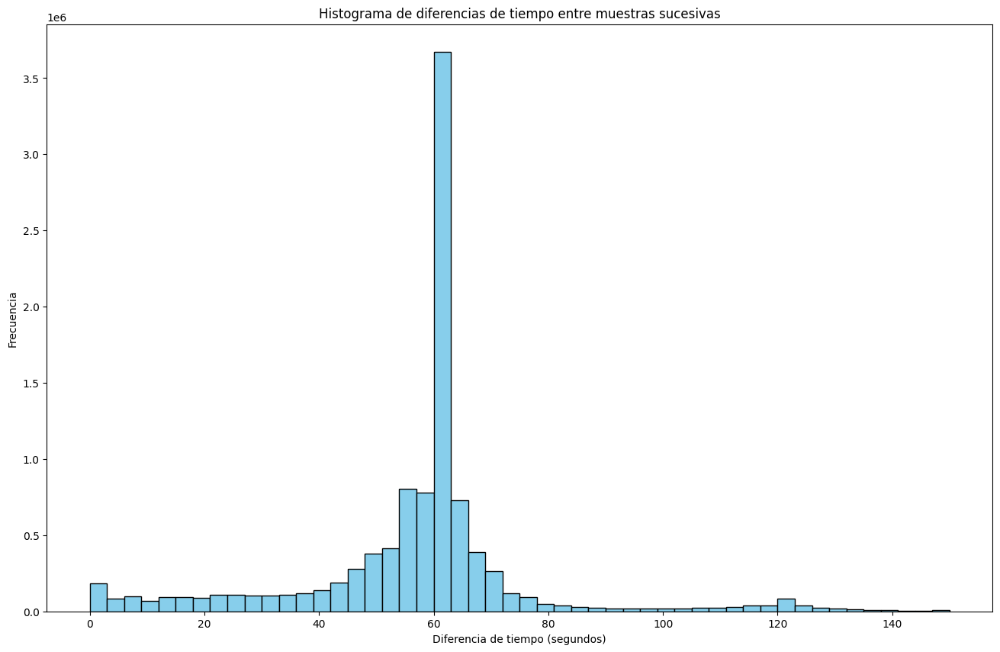

In [ ]:
df['time'] = pd.to_datetime(df['time_conv'])
df['time_dif'] = df.groupby('id')['time'].diff()
df['time_dif'] = df['time_dif'].dt.total_seconds()
df['time_dif'] = df['time_dif'].abs()

umbral_parada = 50 #tiempo considerado como una parada.

df['stop'] = (df['time_dif'] > umbral_parada).astype(int)

plt.hist(df['time_dif'], bins=50, range=(0, 150), color='skyblue', edgecolor='black')
plt.xlabel('Diferencia de tiempo (segundos)')
plt.ylabel('Frecuencia')
plt.title('Histograma de diferencias de tiempo entre muestras sucesivas')
plt.show()

# 6.1. Correlación entre ocupación y paradas
Graficar correlación entre 'occ' y 'stop'
¿Qué se puede concluir a partir de los valores?


In [ ]:
df.head()

,id,lat,long,occ,time,time_conv,hour,day_of_week,nombre_dia,time_dif,stop
0,ayshekki,37.66635,-122.42869,0.0,2008-06-09 07:13:42,2008-06-09 07:13:42,7,0,Lunes,NaN,0
1,ayshekki,37.66642,-122.42865,0.0,2008-06-09 07:12:51,2008-06-09 07:12:51,7,0,Lunes,51.0,1
2,ayshekki,37.66768,-122.42524,0.0,2008-06-09 07:11:41,2008-06-09 07:11:41,7,0,Lunes,70.0,1
3,ayshekki,37.66859,-122.41505,0.0,2008-06-09 07:10:51,2008-06-09 07:10:51,7,0,Lunes,50.0,0
4,ayshekki,37.66530,-122.40215,0.0,2008-06-09 07:09:41,2008-06-09 07:09:41,7,0,Lunes,70.0,1


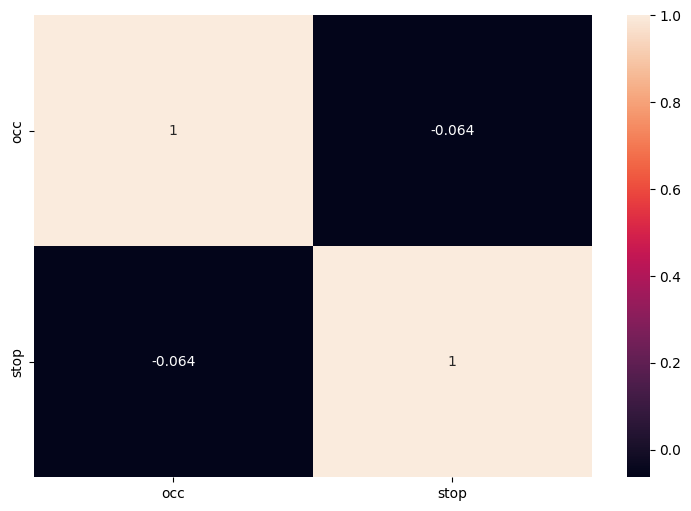

In [ ]:
f,ax = plt.subplots(figsize=(9,6))
sns.heatmap(df[["occ","stop"]].corr(), annot = True)
plt.show()

La conclusión que se puede sacar es que siempre que están parados los taxis, nunca tienen ocupante, lo que tiene sentido ya que no van a esar parados con el cliente

# 6.2. Correlación entre todos los datos del dataframe
¿Existe alguna otra alta o baja correlación observable que permita estimar conclusiones sobre el dataset?

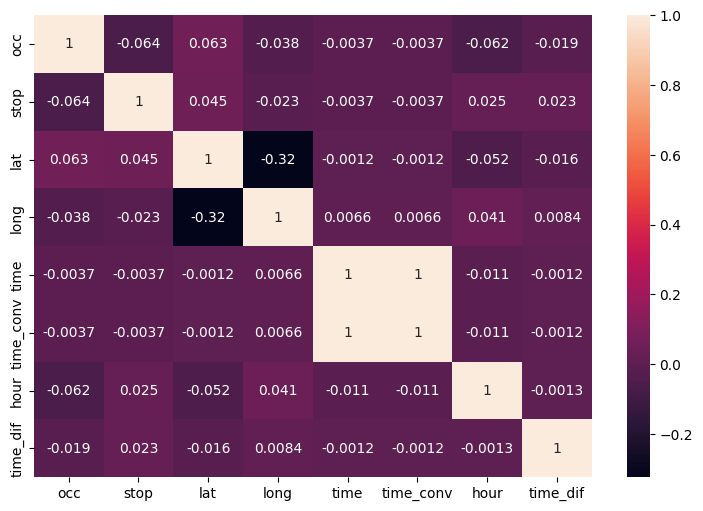

In [ ]:
f,ax = plt.subplots(figsize=(9,6))
sns.heatmap(df[["occ","stop","lat","long","time","time_conv","hour","time_dif"]].corr(), annot = True)
plt.show()

# 7. Relacionar paradas con localizaciones
Realizar gráfica de localizaciones como en el ejercicio 3
Marcar todas las localizaciones con color azul, y con color rojo donde ha habido paradas
Adicional: Realizar lo mismo pero con mapa de calor

In [ ]:
df_g = df.groupby('id').agg({'lat': lambda x: list(x),
                                   'long': lambda x: list(x),
                                   'occ': lambda x: list(x),
                                   'stop': lambda x: list(x)})

Primero creamos un dataframe agrupado con los datos que vamos a necesitar para las paradas

In [ ]:
df_g

,lat,long,occ,stop
id,,,,
abboip,"[37.75134, 37.75136, 37.75199, 37.7508, 37.750...","[-122.39488, -122.39527, -122.3946, -122.39346...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, ..."
abdremlu,"[37.61625, 37.61622, 37.61619, 37.6153, 37.629...","[-122.38587, -122.38583, -122.38588, -122.3897...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, ..."
abgibo,"[37.7638, 37.76127, 37.76128, 37.76517, 37.764...","[-122.39769, -122.39841, -122.39841, -122.4176...","[0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, ...","[0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, ..."
abjoolaw,"[37.76943, 37.77009, 37.77084, 37.7718, 37.772...","[-122.42457, -122.4248, -122.42523, -122.42537...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, ...","[0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, ..."
abmuyawm,"[37.78127, 37.77969, 37.77685, 37.77654, 37.77...","[-122.39581, -122.39374, -122.39518, -122.3954...","[1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, ...","[0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, ..."
...,...,...,...,...
uvburki,"[37.77196, 37.7713, 37.77288, 37.7701, 37.7662...","[-122.40716, -122.40546, -122.40274, -122.3995...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, ..."
uvigcho,"[37.61571, 37.6149, 37.60821, 37.59975, 37.591...","[-122.38804, -122.39129, -122.38852, -122.3759...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, ..."
uvjeahot,"[37.61569, 37.61453, 37.61553, 37.61553, 37.61...","[-122.38797, -122.39479, -122.38991, -122.3899...","[0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...","[0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, ..."


Vamos a analizar las paradas para un solo taxi:

In [ ]:
filtered_data = df_g.loc['abmuyawm']
filtered_data

lat     [37.78127, 37.77969, 37.77685, 37.77654, 37.77...
long    [-122.39581, -122.39374, -122.39518, -122.3954...
occ     [1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, ...
stop    [0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, ...
Name: abmuyawm, dtype: object

Obtenemos las cordenadas de las paradas ( cuando stop =1) para el taxi deseado:

In [ ]:
coordenadas = []
filtered_data = df_g.loc['abmuyawm']

for i in range(len(filtered_data['stop'])):
  if filtered_data['stop'][i] == 1:
    coordenadas.append([filtered_data['lat'][i], filtered_data['long'][i]])

coordenadas

[[37.77969, -122.39374],
 [37.77685, -122.39518],
 [37.7766, -122.39542],
 [37.77595, -122.39642],
 [37.77904, -122.39269],
 [37.78067, -122.39072],
 [37.78254, -122.39342],
 [37.78538, -122.40007],
 [37.78938, -122.40134],
 [37.78896, -122.40232],
 [37.78867, -122.40541],
 [37.78829, -122.408],
 [37.78743, -122.41252],
 [37.7862, -122.42465],
 [37.78718, -122.42476],
 [37.78803, -122.42018],
 [37.78973, -122.42219],
 [37.7932, -122.42305],
 [37.79375, -122.42458],
 [37.79265, -122.42282],
 [37.78907, -122.42503],
 [37.78752, -122.42435],
 [37.78793, -122.41863],
 [37.79032, -122.41447],
 [37.79097, -122.4092],
 [37.79379, -122.40958],
 [37.7944, -122.40981],
 [37.79445, -122.4079],
 [37.79383, -122.4098],
 [37.79321, -122.41417],
 [37.79466, -122.41653],
 [37.7932, -122.4212],
 [37.78985, -122.41984],
 [37.78911, -122.40975],
 [37.79103, -122.40881],
 [37.79144, -122.40859],
 [37.79195, -122.40926],
 [37.79127, -122.41507],
 [37.79093, -122.41738],
 [37.79137, -122.41439],
 [37.79202,

Pintamos el mapa del recorrido junto con el de las paradas:

In [ ]:
# Extraer las coordenadas de latitud y longitud para el recorrido de los taxis
recorrido_lat = filtered_data['lat']
recorrido_long = filtered_data['long']

# Crear un mapa de Folium
m = folium.Map(location=(37.7, -122.4), zoom_start=11)

# Añadir una línea azul para representar el recorrido de los taxis
folium.PolyLine(zip(recorrido_lat, recorrido_long), color="blue", weight=2.5, opacity=1).add_to(m)

# Añadir un círculo rojo para cada parada
for lat, long in coordenadas:
    folium.CircleMarker(location=[lat, long], radius=2, color='red', fill=True, fill_color='red').add_to(m)

# Mostrar el mapa
m

Si nos fijamos en los puntos de paradas justo coinciden con intersecciones de calles lo que puede señalar que se han parado en un semaforo

Pintamos el mapa de calor de las paradas:

In [ ]:
# Extraer las coordenadas de latitud y longitud para el recorrido de los taxis
recorrido_lat = filtered_data['lat']
recorrido_long = filtered_data['long']

# Crear un mapa de Folium
m = folium.Map(location=(37.7, -122.4), zoom_start=11)

# Añadir mapa de calor para las paradas
HeatMap(coordenadas).add_to(m)

# Mostrar el mapa
m

Con el mapa de calor corroboramos que las paradas son mas comunes en las intersecciones. Además podemos ver que tambien hay muchas paradas en las autopistas, que puede ser por los atascos.

# Proposed analysis

## **Trips**


1. Number of trips per vehicle

Hemos considerado trayectos como todos la suma de todos los recorridos entre paradas

Para un taxi cualquiera:

In [ ]:
#para un taxi cualquiera calcular el numero total de viajes
filtered_data = df[df['id'] == 'abmuyawm']
filtered_data['stop'].sum()


16021

Media de todos lo taxis:

In [ ]:
#para todos los taxis  calcular la media del numero total de viajes
num_viajes = []
for id in df['id'].unique():
    filtered_data = df[df['id'] == id]
    num_viajes.append(filtered_data['stop'].sum())
print("Número medio de viajes: ", sum(num_viajes)/len(num_viajes))

Número medio de viajes:  17376.763948497854


2. Travelled distance per Vehicle

Primero la calculamos para un taxi cualquiera:

In [ ]:

distancia_total = 0
for i in range(len(filtered_data)-1):
  distancia_total += calculate_distance(filtered_data['lat'].iloc[i], filtered_data['long'].iloc[i], filtered_data['lat'].iloc[i+1], filtered_data['long'].iloc[i+1])
print("Distancia total recorrida por el taxi: ", distancia_total, "km")

Distancia total recorrida por el taxi:  8026.160166847261 km


Y ahora la media de todos los taxis:

In [ ]:
#calcular la media de la distancia recorrida por todos los taxis
distancias_totales = []
for id in df['id'].unique():
  filtered_data = df[df['id'] == id]
  distancia_total = 0
  for i in range(len(filtered_data)-1):
    distancia_total += calculate_distance(filtered_data['lat'].iloc[i], filtered_data['long'].iloc[i], filtered_data['lat'].iloc[i+1], filtered_data['long'].iloc[i+1])
  distancias_totales.append(distancia_total)
print("Distancia media recorrida por todos los taxis: ", sum(distancias_totales)/len(distancias_totales), "km")

Distancia media recorrida por todos los taxis:  9311.13328972974 km


3. Pick-up points location

In [ ]:
#dibujar en un mapa los puntos en los que ocupation cambia de 0 a 1
filtered_data = df[df['id'] == 'abmuyawm']
coordenadas = []
for i in range(len(filtered_data)-1):
  if filtered_data['occ'].iloc[i] == 0 and filtered_data['occ'].iloc[i+1] == 1:
    coordenadas.append([filtered_data['lat'].iloc[i], filtered_data['long'].iloc[i]])
#dibujar en el mapa las coordenadas
m = folium.Map(location=(37.7, -122.4), zoom_start=11)
for lat, long in coordenadas:
    folium.CircleMarker(location=[lat, long], radius=2, color='red', fill=True, fill_color='red').add_to(m)
m

In [ ]:
m = folium.Map(location=(37.7, -122.4),zoom_start=11)
# Create a HeatMap layer with the latitudes and longitudes from the filtered_data
HeatMap(coordenadas).add_to(m)
# Display the map
m

En estos mapas observamos que la mayoria de puntos de recogida se concentran en la ciudad o en el aeropuerto.

4. Drop-off points location

In [ ]:
#dibujar en un mapa los puntos en los que ocupation cambia de 1 a 0
filtered_data = df[df['id'] == 'abmuyawm']
coordenadas = []
for i in range(len(filtered_data)-1):
  if filtered_data['occ'].iloc[i] == 1 and filtered_data['occ'].iloc[i+1] == 0:
    coordenadas.append([filtered_data['lat'].iloc[i], filtered_data['long'].iloc[i]])
#dibujar en el mapa las coordenadas
m = folium.Map(location=(37.7, -122.4), zoom_start=11)
for lat, long in coordenadas:
    folium.CircleMarker(location=[lat, long], radius=2, color='red', fill=True, fill_color='red').add_to(m)
m

In [ ]:
m = folium.Map(location=(37.7, -122.4),zoom_start=11)
# Create a HeatMap layer with the latitudes and longitudes from the filtered_data
HeatMap(coordenadas).add_to(m)
# Display the map
m

De forma muy similar a los puntos de recogida la mayoria de puntos de dejada se concentran en la ciudad o en el aeropuerto.

Adicionalmente podemos ver que no se deja a nadie en la ciudad de Oakland mientras que si que se recogia gente de ahi

5. Average distance without/with passenger

Copiamos el codigo que habiamos realizado anteriormente:

In [ ]:
distancias_ocupado=[]
distancias_no_ocupado=[]
for id in df['id'].unique():
    filtered_data = df[df['id'] == id]
    ocupado = filtered_data[filtered_data['occ'] == 1][['lat', 'long']]
    no_ocupado = filtered_data[filtered_data['occ'] == 0][['lat', 'long']]
    indice_anterior_ocupado=0
    lista_ocupados =[]
    lista=[]
    for index in ocupado.index:
        if index == indice_anterior_ocupado+1:
            lista.append(ocupado.loc[index])
        else:
            lista_ocupados.append(lista)
            lista=[]
            lista.append(ocupado.loc[index])
        indice_anterior_ocupado=index

    indice_anterior_no_ocupado=0
    lista_no_ocupados =[]
    lista=[]
    for index in no_ocupado.index:
        if index == indice_anterior_no_ocupado+1:
            lista.append(no_ocupado.loc[index])
        else:
            lista_no_ocupados.append(lista)
            lista=[]
            lista.append(no_ocupado.loc[index])
        indice_anterior_no_ocupado=index
    distancias_ocupado_id=[]
    for i in lista_ocupados:
        distancia=0
        for j in range(len(i)-1):
            distancia+=calculate_distance(i[j]['lat'],i[j]['long'],i[j+1]['lat'],i[j+1]['long'])
        distancias_ocupado_id.append(distancia)
    distancias_no_ocupado_id=[]
    for i in lista_no_ocupados:
        distancia=0
        for j in range(len(i)-1):
            distancia+=calculate_distance(i[j]['lat'],i[j]['long'],i[j+1]['lat'],i[j+1]['long'])
        distancias_no_ocupado_id.append(distancia)
    distancia_total_ocupado_id=0
    for i in distancias_ocupado_id:
        distancia_total_ocupado_id+=i
    distancia_total_no_ocupado_id=0
    for i in distancias_no_ocupado_id:
        distancia_total_no_ocupado_id+=i
    distancias_ocupado.append(distancia_total_ocupado_id)
    distancias_no_ocupado.append(distancia_total_no_ocupado_id)


print("Distancia media recorrida por taxis ocupados: ", sum(distancias_ocupado)/len(distancias_ocupado))
print("Distancia media recorrida por taxis no ocupados: ", sum(distancias_no_ocupado)/len(distancias_no_ocupado))

Distancia media recorrida por taxis ocupados:  5015.276210288652
Distancia media recorrida por taxis no ocupados:  4008.9637863896287


6. Average speed without/with passenger

In [ ]:
#6. Average speed without/with passenger
#para un taxi en concreto
filtered_data = df[df['id'] == 'abmuyawm']
velocidades_ocupado = []
velocidades_no_ocupado = []
for i in range(1,len(filtered_data)-1):
  if filtered_data['occ'].iloc[i] == 1:

      velocidad = calculate_distance(filtered_data['lat'].iloc[i], filtered_data['long'].iloc[i], filtered_data['lat'].iloc[i+1], filtered_data['long'].iloc[i+1])/(filtered_data['time_dif'].iloc[i]/3600)
      velocidades_ocupado.append(velocidad)
  else:

      velocidad = calculate_distance(filtered_data['lat'].iloc[i], filtered_data['long'].iloc[i], filtered_data['lat'].iloc[i+1], filtered_data['long'].iloc[i+1])/(filtered_data['time_dif'].iloc[i]/3600)
      velocidades_no_ocupado.append(velocidad)

print("Velocidad media del taxi ocupado: ", sum(velocidades_ocupado)/len(velocidades_ocupado), "km/h")
print("Velocidad media del taxi no ocupados: ", sum(velocidades_no_ocupado)/len(velocidades_no_ocupado), "km/h")

Velocidad media del taxi ocupado:  52.699993276756175 km/h
Velocidad media del taxi no ocupados:  32.536629835452125 km/h


Podemos observar que la velocidad media con el taxi ocupado es bastante superior a la del taxi libre.

Ahora vamos a ver la media de todos los taxis:

In [ ]:
velocidades_ocupado = []
velocidades_no_ocupado = []
for id in df['id'].unique():
    filtered_data = df[df['id'] == id]
    for i in range(1,len(filtered_data)-1):
      if filtered_data['occ'].iloc[i] == 1:

          velocidad = calculate_distance(filtered_data['lat'].iloc[i], filtered_data['long'].iloc[i], filtered_data['lat'].iloc[i+1], filtered_data['long'].iloc[i+1])/(filtered_data['time_dif'].iloc[i]/3600)
          velocidades_ocupado.append(velocidad)
      else:

          velocidad = calculate_distance(filtered_data['lat'].iloc[i], filtered_data['long'].iloc[i], filtered_data['lat'].iloc[i+1], filtered_data['long'].iloc[i+1])/(filtered_data['time_dif'].iloc[i]/3600)
          velocidades_no_ocupado.append(velocidad)
print("Velocidad media de los taxis ocupados: ", sum(velocidades_ocupado)/len(velocidades_ocupado), "km/h")
print("Velocidad media de los taxis no ocupados: ", sum(velocidades_no_ocupado)/len(velocidades_no_ocupado), "km/h")

Velocidad media de los taxis ocupados:  61.568536908932735 km/h
Velocidad media de los taxis no ocupados:  35.352985722466094 km/h


Podemos ver que los taxis ocupados suelen ir casi el doble de rapido que los no ocupados, esto se puede deber a que quizás cuando los taxis no estan ocupados van realizando mas paradas, mientras que cuando estan libres realizan los recorridos directamente

7. Pick-up time

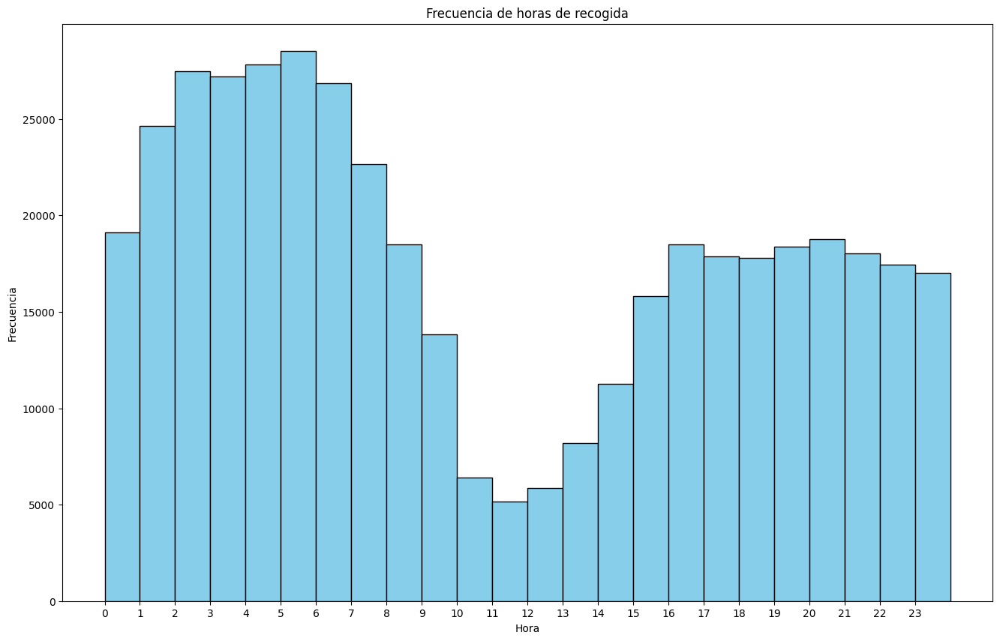

In [ ]:
horas=[]
for id in df['id'].unique():
    filtered_data = df[df['id'] == id]
    for i in range(len(filtered_data)-1):
        if filtered_data['occ'].iloc[i] == 0 and filtered_data['occ'].iloc[i+1] == 1:
            horas.append(filtered_data['hour'].iloc[i])
plt.hist(horas, bins=24, range=(0, 24), color='skyblue', edgecolor='black')
plt.xlabel('Hora')
plt.ylabel('Frecuencia')
plt.title('Frecuencia de horas de recogida')
plt.xticks(range(24))
plt.show()

8. Drop-off time

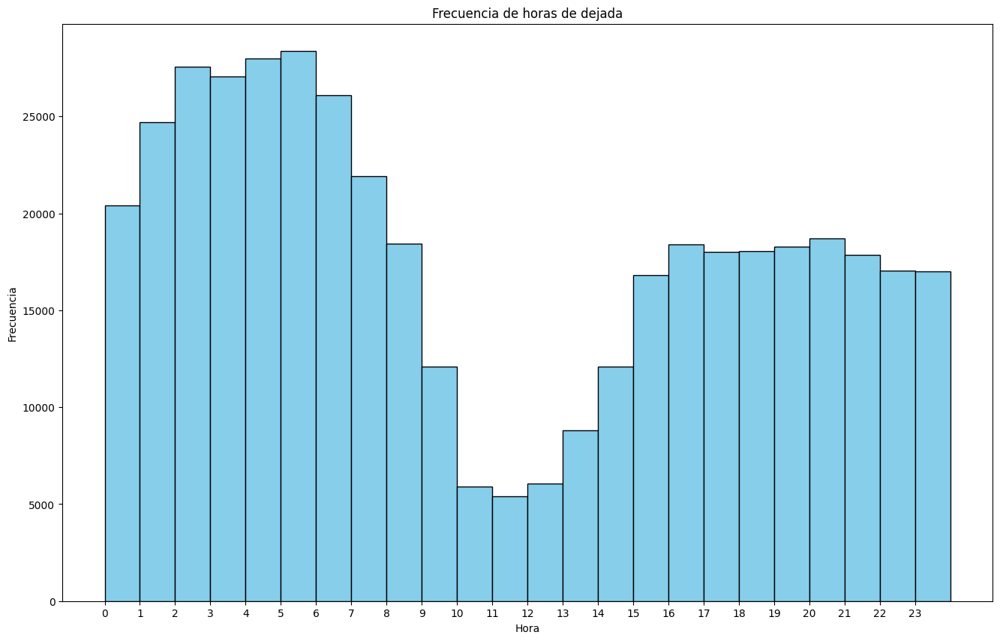

In [ ]:
horas=[]
for id in df['id'].unique():
    filtered_data = df[df['id'] == id]
    for i in range(len(filtered_data)-1):
        if filtered_data['occ'].iloc[i] == 1 and filtered_data['occ'].iloc[i+1] == 0:
            horas.append(filtered_data['hour'].iloc[i])
plt.hist(horas, bins=24, range=(0, 24), color='skyblue', edgecolor='black')
plt.xlabel('Hora')
plt.ylabel('Frecuencia')
plt.title('Frecuencia de horas de dejada')
plt.xticks(range(24))
plt.show()


En ambos gráficos el resultado es muy parecido, lo que nos indica que los viajes se realizan casi siempre a las mismas horas que son duranre la madrugada, de 1-6 y durante la tarde noche de 16-24. Las horas con menos viajes son de las 9 - 12.

9. Average trip duration without/with passenger

In [ ]:
#duración media de un viaje con pasajero y sin pasajero
duracion_ocupado = []
duracion_no_ocupado = []
duracion=0
for id in df['id'].unique():
    filtered_data = df[df['id'] == id]
    for i in range(1,len(filtered_data)-1):
        if filtered_data['occ'].iloc[i] == 0 and filtered_data['occ'].iloc[i+1] == 0:
            duracion=duracion+filtered_data['time_dif'].iloc[i]
        if filtered_data['occ'].iloc[i] == 0 and filtered_data['occ'].iloc[i+1] == 1:
            duracion=duracion+filtered_data['time_dif'].iloc[i]
            duracion_ocupado.append(duracion)
            duracion=0
        if filtered_data['occ'].iloc[i] == 1 and filtered_data['occ'].iloc[i+1] == 1:
            duracion=duracion+filtered_data['time_dif'].iloc[i]
        if filtered_data['occ'].iloc[i] == 1 and filtered_data['occ'].iloc[i+1] == 0:
            duracion=duracion+filtered_data['time_dif'].iloc[i]
            duracion_no_ocupado.append(duracion)
            duracion=0
print("Duración media de un viaje con pasajero: ", (sum(duracion_ocupado)/len(duracion_ocupado))/60, "minutos")
print("Duración media de un viaje sin pasajero: ", (sum(duracion_no_ocupado)/len(duracion_no_ocupado))/60, "minutos")

Duración media de un viaje con pasajero:  25.13109821054706 minutos
Duración media de un viaje sin pasajero:  10.964837314369056 minutos


## **Stops**

1. Número de paradas (>30 min). Oportunidad de carga

In [ ]:
umbral_parada = 1800 #30 minutos de umbral
contador_1 = 0

df['stop'] = (df['time_dif'] > umbral_parada).astype(int)

for i in range(len(df['stop'])):
  if df['stop'][i] == 1:
    contador_1 += 1

contador_1

27853

2. Distancia recorrida entre 2 paradas consecutivas

In [ ]:
#distancia media recorrida entre 2 paradas consecutivas
distancias = []
for id in df['id'].unique():
    filtered_data = df[df['id'] == id]
    latitud = filtered_data['lat'].iloc[0]
    longitud = filtered_data['long'].iloc[0]
    for i in range(1,len(filtered_data)-1):
        if filtered_data['stop'].iloc[i] == 1:
            distancia = calculate_distance(latitud, longitud, filtered_data['lat'].iloc[i], filtered_data['long'].iloc[i])
            distancias.append(distancia)
            latitud = filtered_data['lat'].iloc[i]
            longitud = filtered_data['long'].iloc[i]

print("Distancia media recorrida entre 2 paradas consecutivas: ", sum(distancias)/len(distancias), "km")

Distancia media recorrida entre 2 paradas consecutivas:  7.974279867799332 km


3. Localización de las paradas

In [ ]:
coordenadas = []

for i in range(len(df['stop'])):
  if df['stop'][i] == 1:
    coordenadas.append([df['lat'][i], df['long'][i]])

coordenadas

[[37.61628, -122.38595],
 [37.66368, -122.42869],
 [37.66592, -122.42803],
 [37.66633, -122.42868],
 [37.66715, -122.42775],
 [37.66635, -122.42865],
 [37.66038, -122.42982],
 [37.667, -122.42765],
 [37.65938, -122.42428],
 [37.6685, -122.42398],
 [37.66629, -122.42874],
 [37.77211, -122.43768],
 [37.66631, -122.42856],
 [37.79944, -122.44111],
 [37.61568, -122.3878],
 [37.77241, -122.48936],
 [37.66624, -122.42874],
 [37.66711, -122.42713],
 [37.6663, -122.42869],
 [37.66711, -122.42715],
 [37.66912, -122.3937],
 [37.61409, -122.39472],
 [37.65074, -122.41846],
 [37.66632, -122.42867],
 [37.61476, -122.39222],
 [37.61625, -122.38619],
 [37.66625, -122.42873],
 [37.61568, -122.38753],
 [37.61627, -122.38608],
 [37.66632, -122.42871],
 [37.61633, -122.38617],
 [37.61649, -122.38604],
 [37.61557, -122.38842],
 [37.66568, -122.42839],
 [37.66637, -122.42785],
 [37.61647, -122.38596],
 [37.66619, -122.4279],
 [37.66805, -122.4248],
 [37.66852, -122.42391],
 [37.67685, -122.3887],
 [37.6165

In [ ]:
# Crear un mapa de Folium
m = folium.Map(location=(37.7, -122.4), zoom_start=10)

# Añadir un círculo rojo para cada parada
for lat, long in coordenadas:
    folium.CircleMarker(location=[lat, long], radius=2, color='red', fill=True, fill_color='red').add_to(m)

# Mostrar el mapa
m

Para visualizarlo mejor haremos un mapa de calor:

In [ ]:
m = folium.Map(location=(37.7, -122.4), zoom_start=10)
HeatMap(coordenadas).add_to(m)
m

Ahora analizaremos las paradas para paradas de mayor duración, pongamos por ejemplo de 3 horas:

In [ ]:
umbral_parada = 10800 #3 horas de umbral
contador_1 = 0

df['stop2h'] = (df['time_dif'] > umbral_parada).astype(int)
for i in range(len(df['stop2h'])):
  if df['stop2h'][i] == 1:
    contador_1 += 1

contador_1


7793

In [ ]:
coordenadas = []

for i in range(len(df['stop2h'])):
  if df['stop2h'][i] == 1:
    coordenadas.append([df['lat'][i], df['long'][i]])

In [ ]:
# Crear un mapa de Folium
m = folium.Map(location=(37.7, -122.4), zoom_start=10)

# Añadir un círculo rojo para cada parada
for lat, long in coordenadas:
    folium.CircleMarker(location=[lat, long], radius=2, color='red', fill=True, fill_color='red').add_to(m)

# Mostrar el mapa
m

In [ ]:
m = folium.Map(location=(37.7, -122.4), zoom_start=10)
HeatMap(coordenadas).add_to(m)
m

Vemos que los puntos de parada son muy similares por lo que los podemos tener en cuenta para definir los puntos de recarga y otras méetricas

4. Duración de parada

Calculamos la media de la duración de las paradas:

In [ ]:
valores = []

for i in range(len(df['stop'])):
  if df['stop'][i] == 1:
    valores.append(df['time_dif'][i])

media = sum(valores)/len(valores)
print(media, 'segundos')

10462.502674756759 segundos


In [ ]:
# Convertir segundos a minutos sin decimales
minutos = media / 60

print("Minutos:", minutos)

# Convertir segundos a horas sin decimales
horas = media / 3600

print("Horas:", horas)

Minutos: 174.37504457927932
Horas: 2.9062507429879885


Podemos ver que el tiempo medio de parada son casi 3 horas, lo que permite realizar cargas bastante largas

5. Tiempo inicial de parada

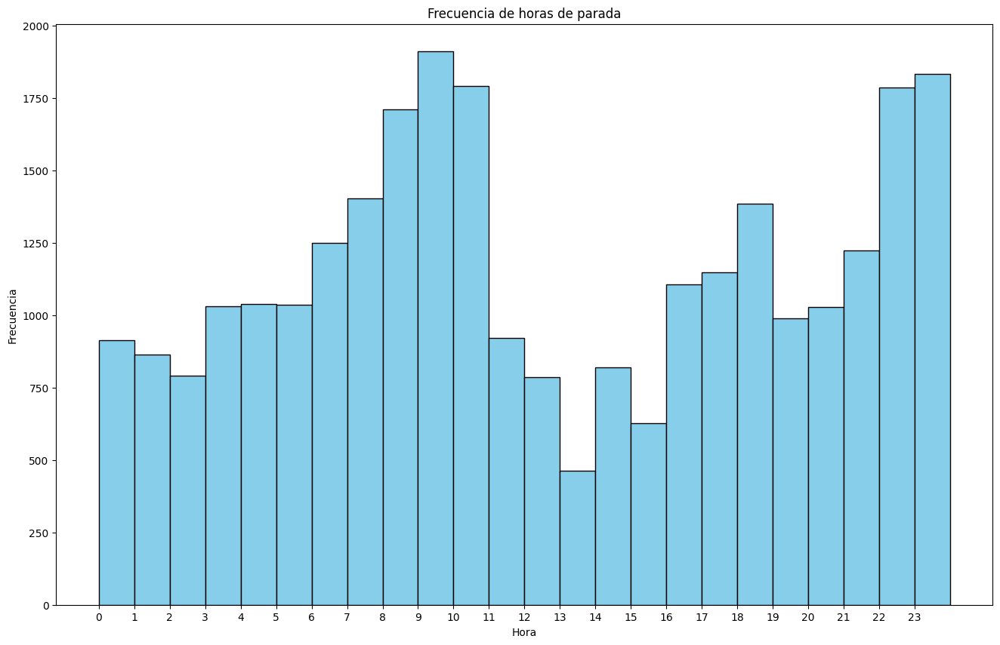

In [ ]:
#hacer un grafico con la hora de las paradas
horas=[]
for i in range(len(df['stop'])):
  if df['stop'][i] == 1:
    horas.append(df['hour'].iloc[i])
plt.hist(horas, bins=24, range=(0, 24), color='skyblue', edgecolor='black')
plt.xlabel('Hora')
plt.ylabel('Frecuencia')
plt.title('Frecuencia de horas de parada')
plt.xticks(range(24))
plt.show()

## **3. Energy**


Vamos a considerar viaje como los trayectos que hay entre que coge un pasajero y se deja y entre que se deja y se coge uno nuevo, es decir hasta que cambie la ocupación del taxi.

Primero calcularemos la distancia media de los viajes así como el trayecto máximo que se haya hecho

In [ ]:
distancias = []
distancia=0
for id in df['id'].unique():
    filtered_data = df[df['id'] == id]
    latitud = filtered_data['lat'].iloc[0]
    longitud = filtered_data['long'].iloc[0]
    for i in range(1,len(filtered_data)-1):
        if filtered_data['occ'].iloc[i] == 0 and filtered_data['occ'].iloc[i+1] == 0:
            distancia=distancia+calculate_distance(latitud, longitud, filtered_data['lat'].iloc[i], filtered_data['long'].iloc[i])
            latitud = filtered_data['lat'].iloc[i]
            longitud = filtered_data['long'].iloc[i]
        if filtered_data['occ'].iloc[i] == 0 and filtered_data['occ'].iloc[i+1] == 1:
            distancia=distancia+calculate_distance(latitud, longitud, filtered_data['lat'].iloc[i], filtered_data['long'].iloc[i])
            distancias.append(distancia)
            latitud = filtered_data['lat'].iloc[i]
            longitud = filtered_data['long'].iloc[i]
            distancia=0
        if filtered_data['occ'].iloc[i] == 1 and filtered_data['occ'].iloc[i+1] == 1:
            distancia=distancia+calculate_distance(latitud, longitud, filtered_data['lat'].iloc[i], filtered_data['long'].iloc[i])
            latitud = filtered_data['lat'].iloc[i]
            longitud = filtered_data['long'].iloc[i]
        if filtered_data['occ'].iloc[i] == 1 and filtered_data['occ'].iloc[i+1] == 0:
            distancia=distancia+calculate_distance(latitud, longitud, filtered_data['lat'].iloc[i], filtered_data['long'].iloc[i])
            distancias.append(distancia)
            latitud = filtered_data['lat'].iloc[i]
            longitud = filtered_data['long'].iloc[i]
            distancia=0
distancia_media=sum(distancias)/len(distancias)
print("Distancia media recorrida en un viaje: ", distancia_media, "km")
distancia_maxima=max(distancias)
print("Distancia máxima recorrida en un viaje: ", distancia_maxima, "km")

Distancia media recorrida en un viaje:  5.009276680927022 km
Distancia máxima recorrida en un viaje:  2877.2076411447556 km



1. Consumo de energía por viaje.


Según los datos proporcionados en el enunciado sabemos que el coche propuesto consume 14,4 kilovatios-hora de energía por cada 100 kilómetros recorridos.

Con la media anteriormente calculada, calculamos la energía media necesaria para los trayectos.

In [ ]:
energia_media=14.4*distancia_media/100
print("Energia_media:",energia_media,"kw/h")

0.7213358420534912

Vemos que realmente en cada trayecto se consume muy poco, apenas un 10% de la bateria total.

Ahora analizaremos cuanto se consume entre 2 paradas largas, que son en las que el taxista podria poner a cargar su coche.

Anteriormente habíamos calculado que la distancia media entre 2 paradas consecutivas (de 30 min o mas) es de 7.974279867799332 km

In [ ]:
energia_media_stop=14.4*7.974279867799332/100
print("Energia_media:",energia_media_stop,"kw/h")

Energia_media: 1.1482963009631038 kw/h


Vemos que tampoco apenas se consume nada de la bateria.

2. Energía demandada a la red durante el proceso de recarga.

La energía demandada será la energía que tiene proporcionar la red cuando se recargue un coche. Como asumimos que no se estarán cargando los coches con cada viaje, si no que los taxistas esperarán a tener una parada larga, vamos a coger el valor calculado para las paradas de 30 min que es de 1.148 kw/h

Teniendo en cuenta la velocidad de carga de los cargadores (carga lenta = 11kW y supercarga 250kW), para suplir esta energía se necesitara:

In [ ]:
energia_demandada=energia_media_stop
velocidad_carga_lenta= 11
velocidad_carga_rápida=250
print("Tiempo necesario para cargar la bateria con carga normal:",energia_demandada/11*60,"minutos")
print("Tiempo necesario para cargar la bateria con carga rapida:",energia_demandada/250*60,"minutos")


Tiempo necesario para cargar la bateria con carga normal: 6.263434368889657 minutos
Tiempo necesario para cargar la bateria con carga rapida: 0.27559111223114485 minutos


Como podemos ver da tiempo de sobra a cargar las baterías y de hecho los taxistas no tendrían por que cargar los coches en cada parada que hacen si no que podrian acumular 5 o 6 paradas sin cargar y cargarlo al final del día.

Ahora calcularemos cuanto será el total de energía demandada en el punto máximo.

Como hemos podido ver en una gráfica anterior la hora en la que mas coches hay parados es de 9-10  y el día con mas servicios es el domingo. Vamos a calcular de cuantos coches hablamos:

In [ ]:
#calcular cuantos taxis hacen parada de 30 minutos un dia cualquiera de la semana entre las 9 y las 10 am
contador_1 = 0
filtered_data = df[(df['hour'] >= 9) & (df['hour'] <= 10) & (df['nombre_dia'] == "Domingo")]
for i in range(len(filtered_data['stop'])):
  if filtered_data['stop'].iloc[i] == 1:
    contador_1 += 1

print("Número de taxis que hacen parada de 30 minutos entre las 9 y las 10 am: ", contador_1)


Número de taxis que hacen parada de 30 minutos entre las 9 y las 10 am:  785


Si todos esos coches se pusiesen a cargar a la misma hora supondría una demanda de 901 kwh:

In [ ]:
energía_maxima=contador_1*energia_media_stop
print("Energía máxima",energía_maxima,"kwh")

Energía máxima 901.4125962560364 kwh


Esta no es una cifra muy elevada ya que no todos los coches cargarían exactamente a la misma hora ni en la misma estación de carga, pero es un cálculo del máximo posible. De todos modos es un valor muy asumible por la ciudad y no supondría ninguna complicación

3. Tasa de electrificabilidad.

In [ ]:
energia_total_consumida = energía_maxima

electrificabilidad = (energia_demandada / energia_total_consumida) * 100

electrificabilidad

0.12738853503184716

# **Additional questions**

1. Proponer los mejores lugares de carga de la ciudad.


Consideramos que los puntos de recarga deberían estar en las zonas en las que los taxis realizan sus paradas para asi optimizar los tiempos.


En las coordenadas 37.751639, -122.394337 es donde mas paradas se concentran, por lo que creemos que ese lugar es donde se guardan los taxis por las noches ya que mirando en google maps coincicde con una empresa de *transporte*

Las otras coordenadas que hemos decidido utilizar son la del aeropuerto (37.616386, -122.386008) y una en el noroeste de la ciudad (37.786784, -122.413199
) en un punto en el que hemos visto que tambien se producen muchas paradas en jones street con gaery street. Por ultimo también pondriamos un punto de recarga en un centro comercial al este de la ciudad en el que tambien se realizan muchas paradas (37.699923, -122.482984)

In [ ]:
m = folium.Map(location=(37.7, -122.4), zoom_start=10)
folium.Marker(location=[37.751639, -122.394337], popup='Punto mas concurrido').add_to(m)
folium.Marker(location=[37.616386, -122.386008], popup='San Francisco Airport').add_to(m)
folium.Marker(location=[37.786784, -122.413199], popup='Punto Noroeste').add_to(m)
folium.Marker(location=[37.699923, -122.482984], popup='Punto Sureste').add_to(m)
m

2. Proponer la forma de optimizar la gestión del taxi según el tráfico.

Se podría optimiazar las cargas de los taxis de tal manera que cuando haya mas tráfico algunos taxis se manden a cargar. De esta forma se reduce el impacto de los taxis en el tráfico. Sin embargo esto puede ser contraproducente para los taxistas ya que las horas de mayor tráfico suelen ser también en las que los taxistas tienen mas trabajo.